In [4]:
import numpy as np
import pandas as pd
import time
import pickle
import warnings
from tqdm import tqdm

import matplotlib.pyplot as plt
import seaborn as sns

import torch
from torch.utils.data import DataLoader
from torch import nn, optim
from torch.nn import functional as F

from structure.data import HMM_Data
from structure.model import ConvNet
from structure.pattern import PatternMatching
from structure.graphics import visualize_secondary_structure
from structure.utils import *
from structure.data_extraction import from_fasta_to_df, from_df_to_fasta

from config import DATA
from pgm.data import SequenceStructureData
from pgm.layers import GaussianLayer, OneHotLayer, DReLULayer
from pgm.edge import Edge
from pgm.model import MRF
from pgm.metrics import aa_acc, l1b_reg, msa_mean, ZeroSumGauge
from pgm.train import train, val, LAYERS_NAME

import sys

ROOT = "/home/malbranke/"
sys.path.append(f"{ROOT}")

torch.cuda.is_available()
device = torch.device('cpu')
warnings.filterwarnings("ignore")

In [5]:
AMINO_ACIDS = 'ACDEFGHIKLMNPQRSTVWY'
DATASET = "PF07736"

batch_size = 300
q = 21
N = 31
k = 10
lamb_l1b = 0.025
gamma = lamb_l1b/(2*q*N)

## SS3 prediction

In [3]:
class HMM_Data(object):
    def __init__(self, file):
        self.primary, self.ss3 = [], []
        data = pickle.load(open(file, 'rb'))
        self.primary = [p[:,:50] for p in data.values()]

    def __len__(self):
        return len(self.primary)
    
    def __getitem__(self, i):
        return self.primary[i]
    
def predict():
    mean_ss3_acc, mean_ss8_acc, n_res = 0,0,0
    model_ss3.eval()
#     denoiser.eval()
    predictions = []
    for batch_idx, data in enumerate(loader):
#         if batch_idx == 300:
#             break
        x = data.float().permute(0, 2, 1).to(device)[:,:40]
        B,_,N = x.size()

        optimizer.zero_grad()
        p_other, p_ss8, p_ss3 = model_ss3(x)
        p_other, p_ss8, p_ss3 = p_other.cpu(), p_ss8.cpu(), p_ss3.cpu()
        x = x.cpu()
        
        p_ss3 = F.softmax(p_ss3,1)
        p_ss8 = F.softmax(p_ss8,1)
        predictions.append(p_ss3[0].permute(1,0).detach().numpy())

    return predictions

In [4]:
dataset = HMM_Data(f"{DATA}/{DATASET}/hmm.pkl")
loader = DataLoader(dataset, batch_size = 1,
                        shuffle=False, drop_last=False)

In [6]:
N, qx, qs, h = 128, 40, 3, 8
# del model
device = torch.device('cpu')

# del model
model_ss3 = ConvNet(qx, qs)
model_ss3 = model_ss3.to(device)
optimizer = optim.Adam(model_ss3.parameters(), lr=0.001)
model_ss3.load_state_dict(torch.load(f"{DATA}/secondary_structure/model_40feats.h5"))
start = time.time()

model_ss3

ConvNet(
  (conv1): ResBlock(
    (conv_1): ConvBlock(
      (conv): Conv1d(40, 100, kernel_size=(11,), stride=(1,), padding=(5,))
      (activation): LeakyReLU(negative_slope=0.2)
      (normalization): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (conv2): ConvBlock(
      (conv): Conv1d(40, 100, kernel_size=(1,), stride=(1,))
      (normalization): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (conv2): ResBlock(
    (conv_1): ConvBlock(
      (conv): Conv1d(100, 200, kernel_size=(11,), stride=(1,), padding=(5,))
      (activation): LeakyReLU(negative_slope=0.2)
      (normalization): BatchNorm1d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (conv2): ConvBlock(
      (conv): Conv1d(100, 200, kernel_size=(1,), stride=(1,))
      (normalization): BatchNorm1d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (conv3): ResBlock(
    (c

In [238]:
ss_prediction = predict()
pickle.dump(ss_prediction, open(f"{DATA}/{DATASET}/ss3.pkl", "wb"))
del ss_prediction

## Pattern Matching

In [13]:
n_patterns, c_patterns, _ =  pickle.load(open(f"{DATA}/{DATASET}/patterns.pkl","rb"))
regexes = []
for x in n_patterns:
    if len(x):
        regexes.append([(i,None,None) for i in x])
Q,T,pi = pickle.load(open(f"{DATA}/secondary_structure/statistics.pkl", "rb"))
T = torch.zeros(*T.shape)
matchers = [PatternMatching(pattern = regex, 
                            Q = Q, T = T, pi = pi,
                            name = name) for regex, name in zip(regexes, c_patterns)]
data = pickle.load(open(f"{DATA}/{DATASET}/ss3.pkl","rb"))

In [8]:
costs, ss, lss = [], [], []
for matcher in matchers:
    costs_, ss_, lss_ = [], [], []
    len_pat = len(matcher.pattern)
    for i, sample in tqdm(enumerate(data)):
        sample = torch.tensor(sample)
        N = sample.size(0)
        p, ll, a, b, P ,Q = matcher.match(sample)
        t = a[:-1].view(len_pat,-1,1)+b[1:].view(len_pat,1,-1)+P[0, matcher.pattern]+Q[0, matcher.pattern]-a[-1,-1]
        lss_.append(t); ss_.append(p); costs_.append((ll,a[-1,-1]))
    lss.append(lss_); ss.append(ss_); costs.append(costs_)

3074it [00:52, 58.25it/s]
3074it [00:59, 51.85it/s]


In [10]:
costs2 = torch.tensor([[c[1].item() for c in cs] for cs in costs]).t()
x = torch.zeros(*costs2.size())
x[torch.arange(costs2.size(0)),costs2.argmax(1)] = 1

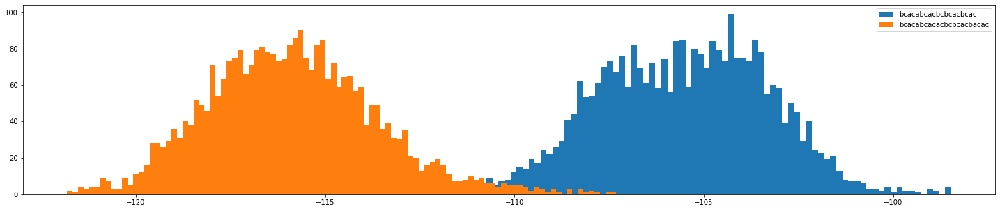

In [12]:
plt.figure(figsize=(25,5))
excluded_pattern = ["cbc", "acaca"]
for cs, m in zip(costs2.t(), c_patterns):
#     print(m)
    if m in excluded_pattern:
        continue
    plt.hist(cs.clamp(-150,0),bins = 100)
plt.legend([c for c in c_patterns if c not in excluded_pattern])
plt.show()

In [16]:
REF_PATTERN_ID = 1

ts = lss[REF_PATTERN_ID]; a = np.zeros((len(ts), len(ts[0]), 30))
for i, t in enumerate(ts):
    for j in range(30):
        a[i, :, j] = np.trace(torch.exp(t).numpy(), offset = j, axis1 = 1, axis2 = 2)

In [244]:
df = from_fasta_to_df(f"{DATA}/{DATASET}/aligned.fasta")
AMINO_ACIDS = '-ACDEFGHIKLMNPQRSTVWY'
AA_IDS = {l: i for i, l in enumerate(AMINO_ACIDS)}

raw_sequences = np.array(list(df["aligned_seq"].apply(lambda s: np.array([AA_IDS[c] if c in AA_IDS.keys() else 0 for c in s]))))
del df

ss_sequences = np.zeros(raw_sequences.shape)
for i,(x,s) in tqdm(enumerate(zip(raw_sequences,ss_[REF_PATTERN_ID]))):
    idx = np.where(x > 0)[0]
    ss_sequences[i,idx] = s.numpy()+1

ss_transitions = np.zeros((raw_sequences.shape[0],7))
for i,(x,s) in tqdm(enumerate(zip(raw_sequences,a))):
    ss_transitions[i] = s

hmms = np.zeros((raw_sequences.shape[0],raw_sequences.shape[1],40))
for i,(x,s) in tqdm(enumerate(zip(raw_sequences,dataset.primary))):
    idx = np.where(x > 0)[0]
    hmms[i, idx] = dataset.primary[i][:, :40]

ss_sequences = np.array(ss_sequences, dtype=int)
ss_transitions = np.array(ss_transitions, dtype=int)

raw_sequences = np.array([to_onehot(seq, (None, len(AA_IDS))) for seq in raw_sequences])
ss_sequences = np.array([to_onehot(seq, (None, 4)) for seq in ss_sequences])
ss_transitions = np.array([to_onehot(seq, (None, 10)) for seq in ss_transitions])

pickle.dump([raw_sequences,ss_sequences,ss_transitions, hmms], open(f"{DATA}/{DATASET}/rbm_data.pkl", "wb"))

9904it [00:00, 103032.63it/s]
9904it [00:00, 925794.22it/s]
9904it [00:00, 67921.62it/s]


## Data

In [3]:
device = torch.device('cpu')

In [4]:
AMINO_ACIDS = '-ACDEFGHIKLMNPQRSTVWY'
AA_IDS = {l: i for i, l in enumerate(AMINO_ACIDS)}
df = from_fasta_to_df(f"{DATA}/{DATASET}/aligned.fasta")

raw_sequences = np.array(list(df["aligned_seq"].apply(lambda s: np.array([AA_IDS[c] if c in AA_IDS.keys() else -1 for c in s]))))
IDX = ((raw_sequences == -1).max(0) == False)
del df

In [5]:
train_dataset = SequenceStructureData(f"{DATA}/{DATASET}")
train_loader = DataLoader(train_dataset, batch_size = batch_size, 
                          shuffle = True, drop_last = True)

val_dataset = SequenceStructureData(f"{DATA}/{DATASET}", train = False)
val_loader = DataLoader(val_dataset, batch_size = batch_size, drop_last = True)

In [6]:
pots = np.zeros((train_dataset.raw_sequences.shape[1], train_dataset.raw_sequences.shape[2]))
for w, v in zip(train_dataset.weights,train_dataset.raw_sequences):
    pots += w*v
pots /= np.sum(train_dataset.weights)
pots = pots.T
pots = torch.FloatTensor((pots.T-np.mean(pots, 1)).T).view(-1).to(device)

In [7]:
pots2 = np.zeros((train_dataset.ss_sequences.shape[1], train_dataset.ss_sequences.shape[2]))
for w, v in zip(train_dataset.weights,train_dataset.ss_sequences):
    pots2 += w*v
pots2 /= np.sum(train_dataset.weights)
pots2 = pots2.T
pots2 = torch.FloatTensor((pots2.T-np.mean(pots2, 1)).T).view(-1).to(device)

In [8]:
pots3 = np.zeros((train_dataset.ss_transitions.shape[1], train_dataset.ss_transitions.shape[2]))
for w, v in zip(train_dataset.weights,train_dataset.ss_transitions):
    pots3 += w*v
pots3 /= np.sum(train_dataset.weights)
pots3 = pots3.T
pots3 = torch.FloatTensor((pots3.T-np.mean(pots3, 1)).T).view(-1).to(device)

## RBM

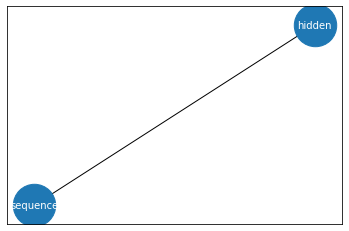

In [17]:
visible_layers = ["sequence"]
hidden_layers = ["hidden"]

v = OneHotLayer(pots, N=68, q=21, name="sequence")
h = GaussianLayer(N=200, name="hidden")

E = [(v.name, h.name)]

model1 = MRF(layers={v.name: v,
                    h.name: h},
            edges=E).to(device)

for visible in visible_layers:
    edge = model1.get_edge(visible, "hidden")
    edge.gauge = edge.gauge.to(device)
    
model1.load(f"{DATA}/{DATASET}/weights/seq-reg-200_1200.h5")

optimizer = optim.Adam(model1.parameters(), lr=0.001)

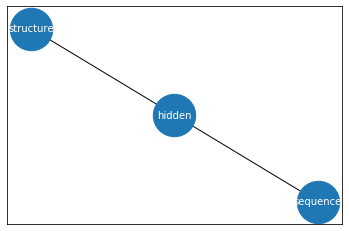

In [10]:
visible_layers = ["sequence", "structure"]
hidden_layers = ["hidden"]

v = OneHotLayer(pots, N=68, q=21, name="sequence")
s = OneHotLayer(pots2, N=68, q=4, name="structure")
h = GaussianLayer(N=200, name="hidden")

E = [(v.name, h.name),
     (s.name, h.name),
     ]

model2 = MRF(layers={v.name: v,
                    s.name: s,
                    h.name: h},
            edges=E).to(device)

for visible in visible_layers:
    edge = model2.get_edge(visible, "hidden")
    edge.gauge = edge.gauge.to(device)

model2.load(f"{DATA}/{DATASET}/weights/seq-struct-reg-200_1200.h5")
optimizer = optim.Adam(model2.parameters(), lr=0.001)

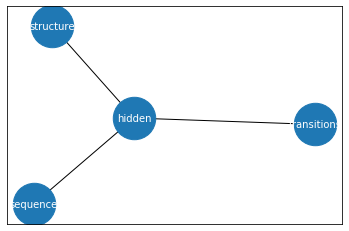

In [11]:
visible_layers = ["sequence", "structure", "transitions"]
hidden_layers = ["hidden"]

v = OneHotLayer(pots, N=68, q=21, name="sequence")
s = OneHotLayer(pots2, N=68, q=4, name="structure")
t = OneHotLayer(pots3, N=7, q=10, name="transitions")
h = GaussianLayer(N=200, name="hidden")

E = [(v.name, h.name),
     (s.name, h.name),
     (t.name, h.name),
     ]

model3 = MRF(layers={v.name: v,
                    s.name: s,
                    t.name: t,
                    h.name: h},
            edges=E).to(device)

for visible in visible_layers:
    edge = model3.get_edge(visible, "hidden")
    edge.gauge = edge.gauge.to(device)
    
model3.load(f"{DATA}/{DATASET}/weights/seq-structure-transitions-reg-200_1200.h5")
optimizer = optim.Adam(model3.parameters(), lr=0.001)

In [ ]:
for epoch in range(1, 6001):
    train(model1, optimizer, train_loader, visible_layers, hidden_layers, gamma, epoch,
          savepath=f"{DATA}/{DATASET}/weights/test-200")
    if not epoch % 30:
        val(model1, val_loader, visible_layers, hidden_layers, epoch)

In [38]:
def sample(model, n_samples, visible_layers, hidden_layers):
    samples = []
    while(True):
        for batch_idx, data in enumerate(train_loader):
            d_0 = {k: v.float().permute(0, 2, 1).to(device) for k, v in zip(LAYERS_NAME, data[:-1]) if k in visible_layers}
            batch_size, q, N = d_0["sequence"].size()
            hmms = data[-2].permute(0,2,1)
            # Sampling
            if model == "reference":
                d_f = d_0
            else:
                _, d_f = model.gibbs_sampling(d_0, visible_layers, hidden_layers, k=30)
            for hmm, x in zip(hmms,d_f["sequence"]):
                hmm[:20] = x[1:]
                samples.append(x)
            if len(samples) >= n_samples:
                break
        if len(samples) >= n_samples:
            break
    return samples

In [39]:
device = torch.device("cpu")
n_samples_per_model = 4800
samples = []
models = ["reference", model1, model2, model3]
visible_layers_list = [["sequence"], ["sequence"],["sequence", "structure"],["sequence", "structure", "transitions"]]
for model, visible_layers in zip(models, visible_layers_list):
    samples.append(sample(model, n_samples_per_model, visible_layers, ["hidden"]))

In [ ]:
f_1 = (sum(samples[0])/n_samples_per_model)[:, IDX]
f_2 = torch.zeros(21,21,31,31)
for s in tqdm(samples[0]):
    x2 = s[:,IDX].view(21,1,31,1)*s[:,IDX].view(1,21,1,31)
    f_2 += x2/n_samples_per_model
    f_3 += x2.view(21,21,1,31,31,1)*s[:,IDX].view(1,1,21,1,1,31)/n_samples_per_model

In [ ]:
C = f_2  - f_1.view(21,1,31,1)*f_1.view(1,21,1,31)
# for c in C.permute(2,3,0,1).view(-1,21,21):
#     nC.append((C**2).sum(0).sum(0)**(0.5))
nC = (C**2).sum(0).sum(0)**(0.5)
sns.heatmap(nC)
plt.show()

In [25]:
def predict(samples):
    device = torch.device("cpu")

    mean_ss3_acc, mean_ss8_acc, n_res = 0,0,0
    model_ss3.eval()
#     denoiser.eval()
    predictions = []
    for i, data in enumerate(samples):
#         if batch_idx == 300:
#             break
        x = data.float().view(1, 40, -1).to(device)[:,:40]

        optimizer.zero_grad()
        p_other, p_ss8, p_ss3 = model_ss3(x)
        p_other, p_ss8, p_ss3 = p_other.cpu(), p_ss8.cpu(), p_ss3.cpu()
        x = x.cpu()
        
        p_ss3 = F.softmax(p_ss3,1)
        p_ss8 = F.softmax(p_ss8,1)
        predictions.append(p_ss3[0].permute(1,0).detach().numpy())

    return predictions

In [28]:
n_patterns, c_patterns, _ =  pickle.load(open(f"{DATA}/{DATASET}/patterns.pkl","rb"))
regexes = []
for x in n_patterns:
    if len(x):
        regexes.append([(i,None,None) for i in x])
Q,T,pi = pickle.load(open(f"{DATA}/secondary_structure/statistics.pkl", "rb"))
Q = np.zeros(Q.shape)
matcher = [PatternMatching(pattern = regex, 
                            Q = Q, T = T, pi = pi,
                            name = name) for regex, name in zip(regexes, c_patterns)][0]

ss3_predictions = []
for s in samples:
    ss3_predictions.append(predict(s))

In [20]:
costs = []
transitions = []
len_pat = len(matcher.pattern)

matching = []
for batch in ss3_predictions:
    trs = []
    for sample in tqdm(batch):
    #     for j, (k,v) in enumerate(ss3_dict.items()):
    #         print(f"Step {i}/{len(matchers)} : [{int(100*j/len(data))}%]", end="\r")
        sample = torch.tensor(sample)
        N = sample.shape[0]
        p, ll, a, b, P ,Q = matcher.match(sample)
        t = a[:-1].view(len_pat,-1,1)+b[1:].view(len_pat,1,-1)+P[0, matcher.pattern]+Q[0, matcher.pattern]-a[-1,-1]
        costs.append((a[-1,-1]).clamp(-30, 0).item())
        tr = []
        for i in range(20):
            tr.append(np.trace(torch.exp(t).numpy(), offset = i, axis1 = 1, axis2 = 2))
        tr = np.array(tr).T
        trs.append(tr)
    transitions.append(trs)
    matching.append(costs)
    costs = []

100%|██████████| 4800/4800 [00:36<00:00, 132.30it/s]


In [21]:
transitions = [np.array(t) for t in transitions]
for i in range(len(transitions)):
    transitions[i] = transitions[i][~np.isnan(transitions[i]).max(1).max(1)]
reference = transitions[0].mean(0)
mean_transitions = [t.mean(0) for t in transitions]
divs = np.array([(t * (np.log(t+1e-8) - np.log(reference+1e-8))).sum(-1) for t in mean_transitions])
# divs = np.array([np.array([(reference * (np.log(reference+1e-8) - np.log(t+1e-8))).sum(-1) for t in tr]).mean(0) for tr in transitions])

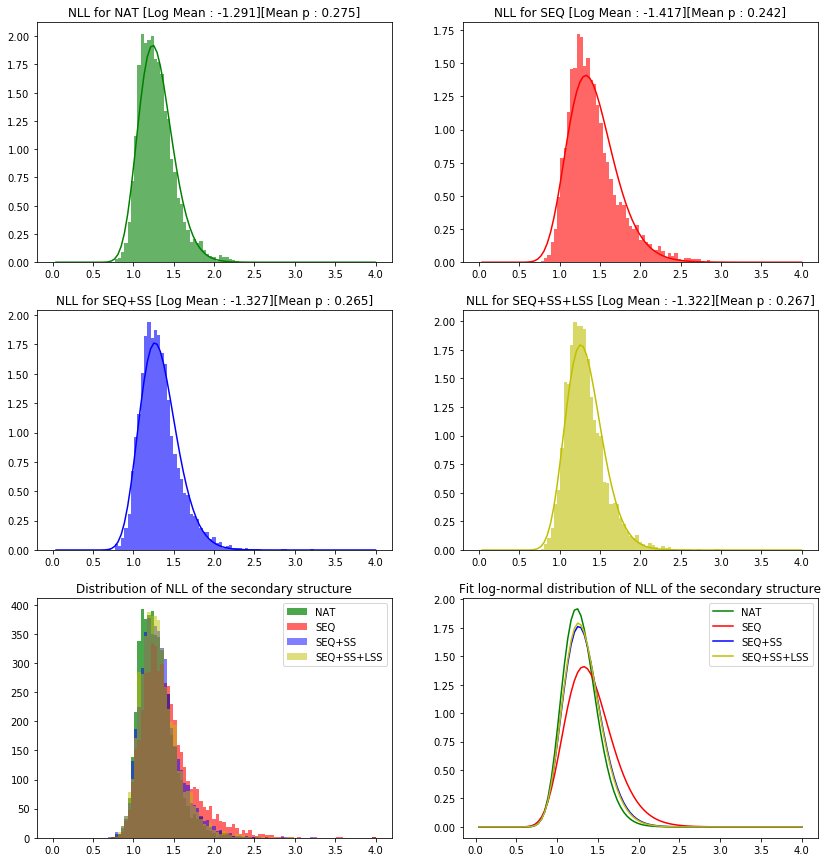

In [100]:
from scipy.stats import truncnorm, gamma, invgauss
plt.figure(figsize = (14,15))

x = np.linspace(0, 4, 100)
pdfs = []
for i, (name,col) in enumerate(zip(["NAT","SEQ", "SEQ+SS", "SEQ+SS+LSS"],["g","r","b","y"])):
    plt.subplot(3,2,i+1)
    mu, std = np.log(-np.array(matching)).mean(1)[i], np.log(-np.array(matching)).std(1)[i]
    a,b = torch.tensor((mu-mini)**2 / std), torch.tensor(mu/std)
    pdf = (np.exp(-(np.log(x) - mu)**2 / (2 * std**2)) / (x * std * np.sqrt(2 * np.pi)))
    pdfs.append(pdf)
    plt.plot(x, pdf, color = col)
    plt.hist(-np.array(matching[i]).clip(-4,0), normed=True, bins=np.linspace(0, 4, 100), alpha=0.6, color = col)
    plt.title(f"NLL for {name} [Log Mean : {np.array(matching[i]).mean(0):.3f}][Mean p : {np.exp(np.array(matching[i]).mean(0)):.3f}]")

plt.subplot(325)
plt.hist(-np.array(matching[0]).clip(-4,0), bins=np.linspace(0, 4, 100), alpha=0.7, color = "g")
plt.hist(-np.array(matching[1]).clip(-4,0), bins=np.linspace(0, 4, 100), alpha=0.6, color = "r")
plt.hist(-np.array(matching[2]).clip(-4,0), bins=np.linspace(0, 4, 100), alpha=0.5, color = "b")
plt.hist(-np.array(matching[3]).clip(-4,0), bins=np.linspace(0, 4, 100), alpha=0.5, color = "y")
plt.legend(["NAT","SEQ", "SEQ+SS", "SEQ+SS+LSS"])
plt.title("Distribution of NLL of the secondary structure")

plt.subplot(326)
plt.plot(np.linspace(0, 4, 100), pdfs[0], color = "g")
plt.plot(np.linspace(0, 4, 100), pdfs[1], color = "r")
plt.plot(np.linspace(0, 4, 100), pdfs[2], color = "b")
plt.plot(np.linspace(0, 4, 100), pdfs[3], color = "y")
plt.legend(["NAT","SEQ", "SEQ+SS", "SEQ+SS+LSS"])
plt.title("Fit log-normal distribution of NLL of the secondary structure")


plt.show()

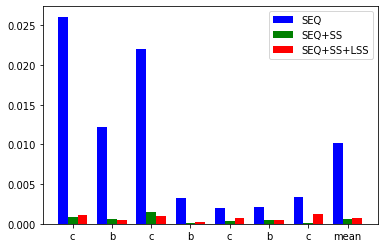

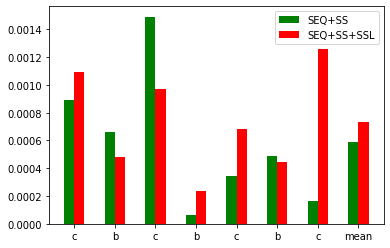

In [25]:
w = 0.25
x = np.arange(8)
y = np.array([list(divs[1])+[divs[1].mean()], list(divs[2])+[divs[2].mean()], list(divs[3])+[divs[3].mean()]])

plt.figure()
plt.bar(x-w, y[0], width=w, color='b', align='center')
plt.bar(x, y[1], width=w, color='g', align='center')
plt.bar(x+w, y[2], width=w, color='r', align='center')
plt.legend(["SEQ", "SEQ+SS", "SEQ+SS+LSS"])
plt.xticks(x, ["c","b","c","b","c","b","c","mean"])
plt.show()

# y = y/y[0]

plt.figure()
# plt.bar(x-w, y[0], width=w, color='b', align='center')
plt.bar(x-w/2, y[1], width=w, color='g', align='center')
plt.bar(x+w/2, y[2], width=w, color='r', align='center')
plt.legend(["SEQ+SS", "SEQ+SS+SSL"])
plt.xticks(x, ["c","b","c","b","c","b","c","mean"])
plt.show()

### Secondary Structure

In [34]:
import sys

ROOT = "/home/malbranke/"
sys.path.append(f"{ROOT}/PGM3/source/")
sys.path.append(f"{ROOT}/PGM3/utilities/")

import Proteins_utils, sequence_logo, structure_logo, utilities10 as utilities, sequence_logo, structure_logo, plots_utils

def get_beta(W,include_gaps=False):
    if not include_gaps:
        W_ = W[:,:,:-1]
    else:
        W_ = W
    return  np.sqrt( (W_**2).sum(-1).sum(-1) ).numpy()

In [72]:
IDX2 = list(range(1, 21))+[0]

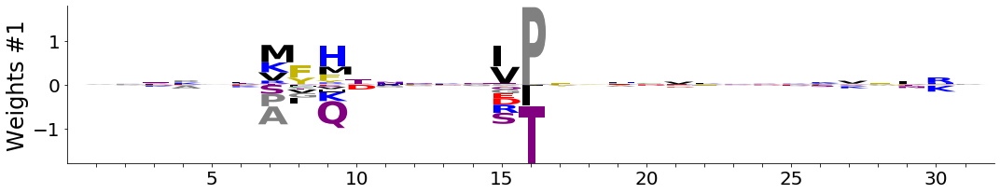

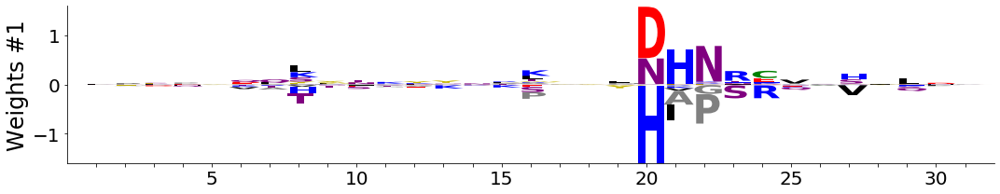

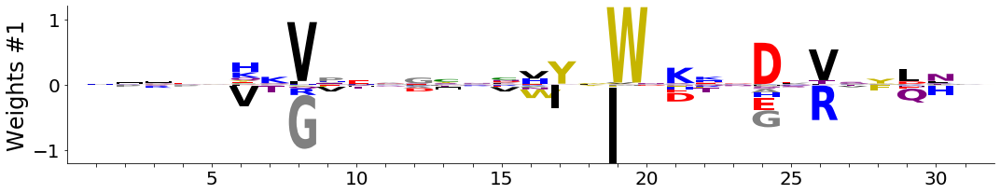

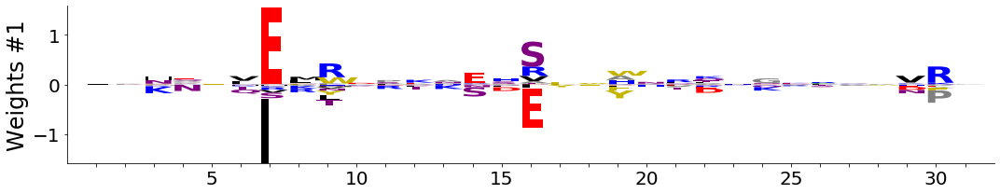

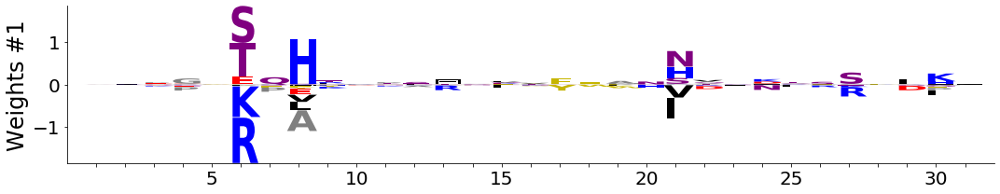

...

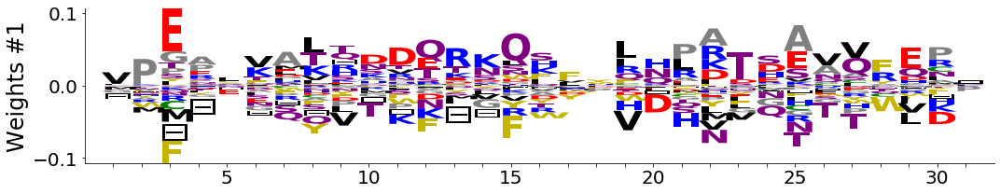

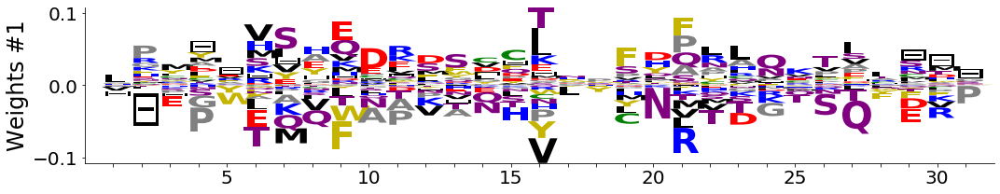

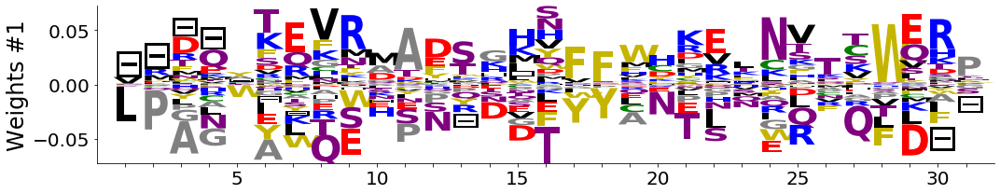

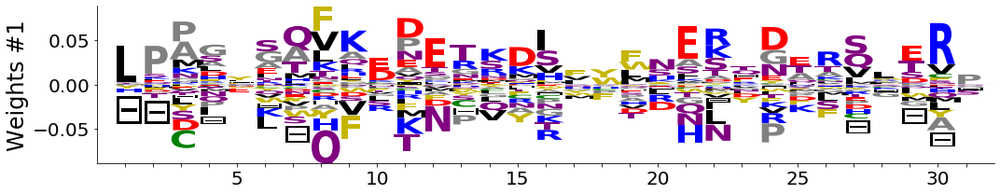

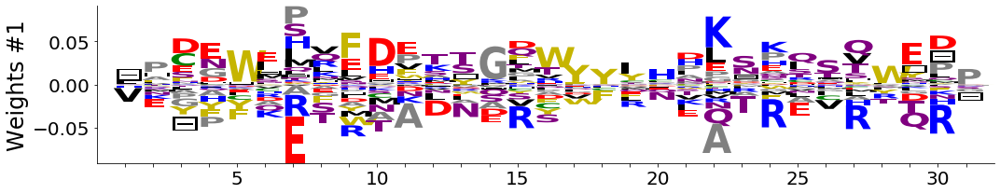

In [80]:
max_acti = model1.get_edge("sequence", "hidden").get_weights().detach().view(-1, 21, 68).permute(0,2,1)[:,IDX]
max_acti = max_acti[:,:,IDX2]

order = np.argsort(get_beta(max_acti))[::-1]
for i in order:
#     print(f"weight #{i}")
    sequence_logo.Sequence_logo_multiple(max_acti.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)

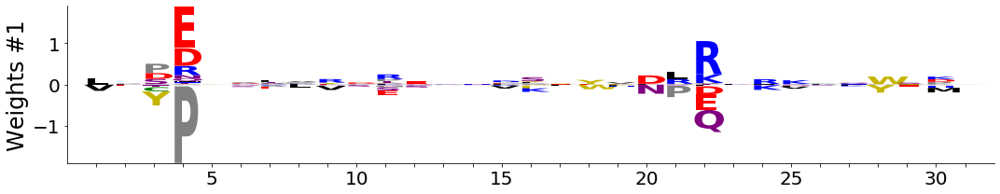

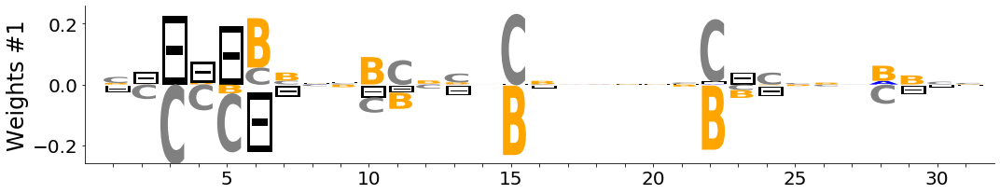

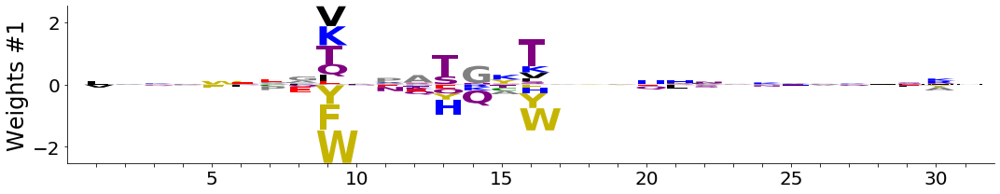

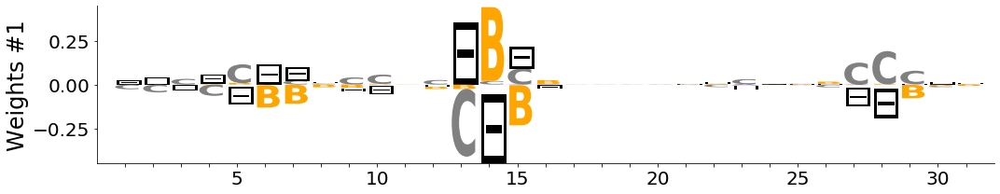

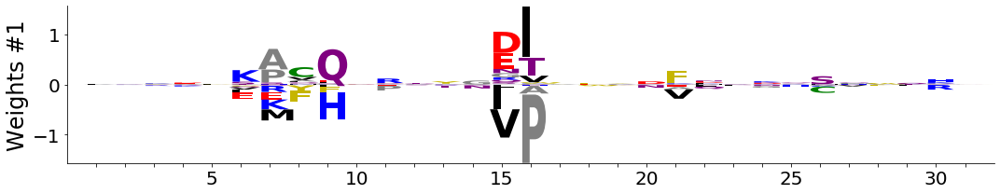

...

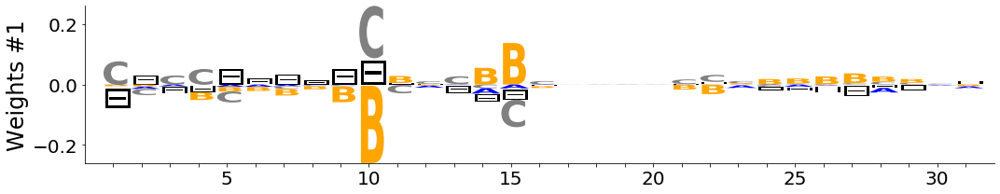

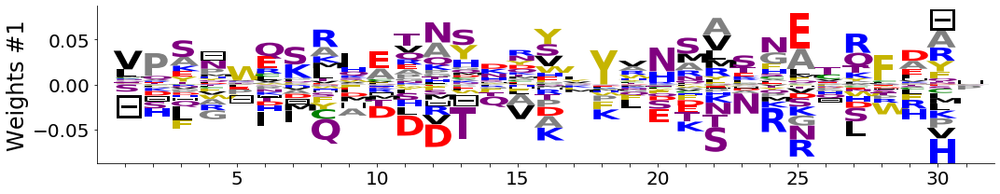

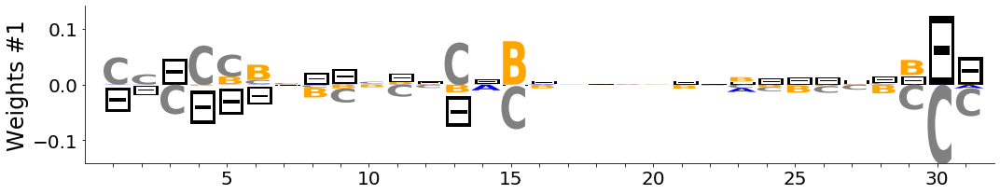

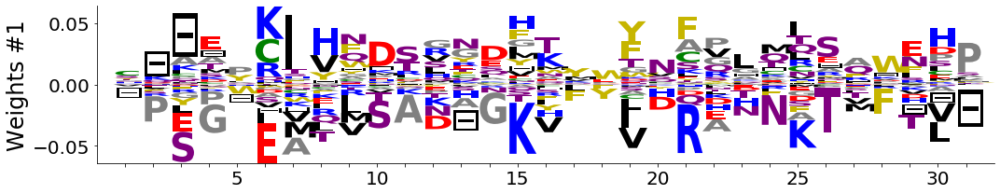

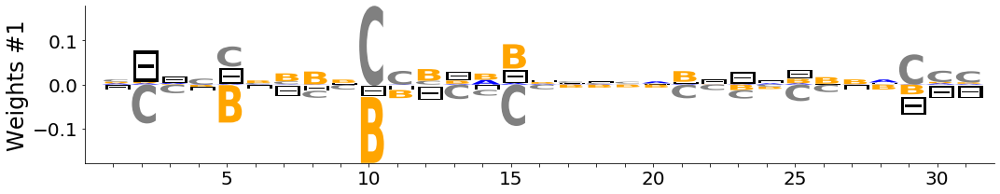

In [78]:
max_acti = model2.get_edge("sequence", "hidden").get_weights().detach().view(-1, 21, 68).permute(0,2,1)[:,IDX]
max_acti = max_acti[:,:,IDX2]
max_acti2 = model2.get_edge("structure", "hidden").get_weights().detach().view(-1, 4, 68).permute(0,2,1)[:,IDX]

order = np.argsort(get_beta(max_acti[:,:,:-1]))[::-1]
for i in order:
#     print(f"weight #{i}")
    sequence_logo.Sequence_logo_multiple(max_acti.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)
    structure_logo.Sequence_logo_multiple(max_acti2.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)